In [ ]:
pip install autogluon

In [16]:
pip install tqdm


  Using cached tqdm-4.66.2-py3-none-any.whl (78 kB)


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.

[notice] A new release of pip available: 22.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
import pandas as pd
import time
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.metrics import precision_score, recall_score
from sklearn.metrics import f1_score, roc_auc_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestRegressor
import pandas as pd
import numpy as np
#from autogluon.tabular import TabularDataset, TabularPredictor
#from autogluon.features.generators import AutoMLPipelineFeatureGenerator
from sklearn.preprocessing import RobustScaler
from tqdm import tqdm
#from autogluon.core.metrics import make_scorer
# import  torch
#from autogluon.common import space


In [ ]:
import torch
print(torch.cuda.is_available())

In [4]:
pd.set_option('display.max_columns', 10000)
pd.set_option('display.max_rows', 10000)

In [5]:
data = pd.read_csv('C:/Users/inho0/OneDrive/문서/GitHub/Building_energy_usage_ML/data/train.csv')
test = pd.read_csv('C:/Users/inho0/OneDrive/문서/GitHub/Building_energy_usage_ML/data/test.csv')
#data_encoded.drop(['Unnamed: 0'], axis = 1, inplace = True)

## Columns 설명
id: 건물 ID  

Year_Factor: 날씨 및 에너지 사용 요인이 관찰된 익명화된 연도  

State_Factor: 건물이 위치한 익명화된 상태  

building_class: 건물 분류  

facility_type: 건물 용도 유형  

floor_area: 건물의 바닥 면적(제곱피트)  

year_built: 건물이 건축된 연도  

energy_star_rating: 건물의 에너지 스타 등급  

ELEVATION: 건물 위치의 고도  

january_min_temp: 건물 위치의 1월 최저 기온(화씨)  

january_avg_temp: 건물 위치의 1월 평균 기온(화씨)  

january_max_temp: 건물 위치의 1월 최고 기온(화씨)  

cooling_degree_days: 냉방도일은 해당일의 일일 평균 기온이 화씨 65도를 초과하는 도수입니다. 매달 합산되어 건물 위치의 연간 총액이 산출됩니다.  

heating_degree_days: 난방도일은 해당일의 일일 평균기온이 화씨 65도 이하로 떨어지는 도수입니다. 매달 합산되어 건물 위치의 연간 총액이 산출됩니다.  

precipitation_inches: 건물 위치의 연간 강수량(인치)  

snowfall_inches: 건물 위치의 연간 강설량(인치)  

snowdepth_inches: 건물 위치의 연간 눈 깊이(인치)  

avg_temp: 해당 건물이 위치한 곳의 1년 평균 기온  

days_below_30F: 건물 위치에서 화씨 30도 미만인 총 일수  

days_below_20F: 건물 위치에서 화씨 20도 미만인 총 일수  

days_below_10F: 건물 위치에서 화씨 10도 미만인 총 일수  

days_below_0F: 건물 위치에서 화씨 0도 미만인 총 일수  

days_above_80F: 건물 위치에서 화씨 80도를 넘는 총 일수  

days_above_90F: 건물 위치에서 화씨 90도를 초과하는 총 일수  

days_above_100F: 건물 위치에서 화씨 100도를 초과하는 총 일수  

days_above_110F: 건물 위치에서 화씨 110도를 초과하는 총 일수  

direction_max_wind_speed: 건물 위치에서 최대 풍속을 나타내는 풍향입니다. 360도
나침반 방향으로 제공됩니다(예: 360 = 북쪽, 180 = 남쪽 등).  

direction_peak_wind_speed: 건물 위치의 최고 돌풍 속도에 대한 풍향입니다. 360도 나침반 방향으로 제공됩니다(예: 360 = 북쪽, 180 = 남쪽 등).  

max_wind_speed: 건물 위치의 최대 풍속  

days_with_fog: 건물 위치에 안개가 낀 일수  

타겟변수  
site_eui: 현장 에너지 사용량은 공과금에 반영된 건물의 열 및 전기 소비량입니다.

---

### 목표
##### 건물의 특성(바닥 면적, 시설 유형, 건축 연도, 에너지 스타 등급 등)과 건물 위치의 날씨 데이터(연평균 기온, 연간 총 강수량, 냉방도일, 난방도일 등)를 활용하여, 각 건물의 사이트 에너지 사용 강도(site EUI)를 예측하는 모델을 개발하기
---
에너지 효율이 좋은 건물은 어떤 특징이 있을까? (경제적 효용) --> 중요..!!

### 예상 효과  

-> 에너지 사용 효율 개선: 각 건물의 에너지 사용 패턴을 이해하면, 에너지 소비를 줄이고 에너지 효율을 개선하는 데 도움이 될 수 있습니다.(영향을 주는 환경 변수 관리)     
-> 예측 가능성 제공: 추후 에너지 비용과 관련된 결정을 내릴 때 예산 산정을 효과적으로 할 수 있습니다.


---

In [21]:
print(data.shape)
print(test.shape)

(75757, 64)
(9705, 63)


In [22]:
data.head()

,Year_Factor,State_Factor,building_class,facility_type,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,id
0,1,State_1,Commercial,Grocery_store_or_food_market,61242.0,1942.0,11.0,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0,56.972603,0,0,0,0,14,0,0,0,1.0,1.0,1.0,NaN,248.682615,0
1,1,State_1,Commercial,Warehouse_Distribution_or_Shipping_center,274000.0,1955.0,45.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0,56.972603,0,0,0,0,14,0,0,0,1.0,NaN,1.0,12.0,26.500150,1
2,1,State_1,Commercial,Retail_Enclosed_mall,280025.0,1951.0,97.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0,56.972603,0,0,0,0,14,0,0,0,1.0,NaN,1.0,12.0,24.693619,2
3,1,State_1,Commercial,Education_Other_classroom,55325.0,1980.0,46.0,1.8,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0,56.972603,0,0,0,0,14,0,0,0,1.0,NaN,1.0,12.0,48.406926,3
4,1,State_1,Commercial,Warehouse_Nonrefrigerated,66000.0,1985.0,100.0,2.4,36,50.5,68,35,50.589286,73,40,53.693548,80,41,55.5,78,46,56.854839,84,50,60.5,90,52,62.725806,84,52,62.16129,85,52,64.65,90,47,63.016129,83,43,53.8,72,36,49.274194,71,115,2960,16.59,0.0,0,56.972603,0,0,0,0,14,0,0,0,1.0,1.0,1.0,NaN,3.899395,4


In [7]:
data.describe()

,Year_Factor,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,id
count,75757.000000,7.575700e+04,73920.000000,49048.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,75757.000000,34675.000000,33946.000000,34675.000000,29961.000000,75757.000000,75757.000000
mean,4.367755,1.659839e+05,1952.306764,61.048605,39.506323,11.432343,34.310468,59.054952,11.720567,35.526837,58.486278,21.606281,44.469292,70.897831,32.037171,53.784863,82.661932,44.706179,63.742547,88.987856,51.131763,71.066384,91.400280,60.571604,76.596879,95.543950,58.515068,75.348749,92.572581,50.791689,69.597545,92.171139,38.210911,58.727038,81.135671,28.630397,48.123133,71.202397,22.736777,41.625569,64.496852,1202.250446,4324.957390,42.430651,29.136379,164.862455,56.176705,48.756511,17.447932,4.886532,0.876764,82.709809,14.058701,0.279539,0.002442,66.552675,62.779974,4.190601,109.142051,82.584693,37878.000000
std,1.471441,2.468758e+05,37.053619,28.663683,60.656596,9.381027,6.996108,5.355458,12.577272,8.866697,8.414611,10.004303,6.657142,7.680982,5.577279,2.500473,4.101028,4.200319,2.792919,2.864669,3.415926,2.861681,3.604068,4.177109,4.090275,4.157118,4.441992,3.818895,4.139685,4.290884,3.603773,5.011708,5.093899,2.641300,5.579513,7.153244,4.094207,4.373374,9.014047,5.869386,6.054104,391.561780,824.366727,10.592205,17.810894,175.275869,2.241940,27.587124,14.469435,7.071221,2.894244,25.282913,10.943996,2.252323,0.142140,131.147834,130.308106,6.458789,50.699751,58.255403,21869.306509
min,1.000000,9.430000e+02,0.000000,0.000000,-6.400000,-19.000000,10.806452,42.000000,-13.000000,13.250000,38.000000,-9.000000,25.854839,53.000000,15.000000,40.280000,62.000000,23.000000,46.950000,64.000000,30.000000,54.100000,67.000000,37.000000,54.822581,65.000000,31.000000,56.693548,66.000000,26.000000,53.600000,64.000000,18.000000,44.693548,59.000000,4.000000,30.766667,53.000000,-16.000000,23.790323,42.000000,0.000000,398.000000,0.000000,0.000000,0.000000,44.512329,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,12.000000,1.001169,0.000000
25%,3.000000,6.237900e+04,1927.000000,40.000000,11.900000,6.000000,29.827586,56.000000,2.000000,31.625000,55.000000,13.000000,38.096774,62.000000,26.000000,52.333333,80.000000,42.000000,62.790323,88.000000,50.000000,70.983333,89.000000,57.000000,76.145161,95.000000,57.000000,74.516129,90.000000,47.000000,68.200000,91.000000,35.000000,58.048387,78.000000,23.000000,45.250000,69.000000,17.000000,38.532258,60.000000,1128.000000,3978

In [8]:
test.head()

,Year_Factor,State_Factor,building_class,facility_type,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,id
0,7,State_1,Commercial,Grocery_store_or_food_market,28484.0,1994.0,37.0,2.4,38,50.596774,64,40,54.482143,66,42,56.935484,77,45,58.45,78,49,60.903226,87,51,63.15,97,53,64.258065,85,53,65.854839,88,54,69.766667,104,48,64.193548,91,43,58.05,69,38,51.887097,66,342,2112,25.24,0.0,0,59.894521,0,0,0,0,29,5,2,0,NaN,NaN,NaN,NaN,75757
1,7,State_1,Commercial,Grocery_store_or_food_market,21906.0,1961.0,55.0,45.7,38,50.596774,64,40,54.482143,66,42,56.935484,77,45,58.45,78,49,60.903226,87,51,63.15,97,53,64.258065,85,53,65.854839,88,54,69.766667,104,48,64.193548,91,43,58.05,69,38,51.887097,66,342,2112,25.24,0.0,0,59.894521,0,0,0,0,29,5,2,0,NaN,NaN,NaN,NaN,75758
2,7,State_1,Commercial,Grocery_store_or_food_market,16138.0,1950.0,1.0,59.1,38,50.596774,64,40,54.482143,66,42,56.935484,77,45,58.45,78,49,60.903226,87,51,63.15,97,53,64.258065,85,53,65.854839,88,54,69.766667,104,48,64.193548,91,43,58.05,69,38,51.887097,66,342,2112,25.24,0.0,0,59.894521,0,0,0,0,29,5,2,0,NaN,NaN,NaN,NaN,75759
3,7,State_1,Commercial,Grocery_store_or_food_market,97422.0,1971.0,34.0,35.4,38,50.596774,64,40,54.482143,66,42,56.935484,77,45,58.45,78,49,60.903226,87,51,63.15,97,53,64.258065,85,53,65.854839,88,54,69.766667,104,48,64.193548,91,43,58.05,69,38,51.887097,66,342,2112,25.24,0.0,0,59.894521,0,0,0,0,29,5,2,0,NaN,NaN,NaN,NaN,75760
4,7,State_1,Commercial,Grocery_store_or_food_market,61242.0,1942.0,35.0,1.8,38,50.596774,64,40,54.482143,66,42,56.935484,77,45,58.45,78,49,60.903226,87,51,63.15,97,53,64.258065,85,53,65.854839,88,54,69.766667,104,48,64.193548,91,43,58.05,69,38,51.887097,66,342,2112,25.24,0.0,0,59.894521,0,0,0,0,29,5,2,0,340.0,330.0,22.8,126.0,75761


## EDA

In [6]:
# 'year_built' 열이 0인 행 제거
data = data[data['year_built'] != 0]
# 'year_built' 열이 NaN인 행 제거
data = data.dropna(subset=['year_built'])
# 'id'열 제거
data = data.drop('id', axis=1)

In [7]:
# 인덱스 초기화
data = data.reset_index(drop=True)

### 전체 시각화

In [ ]:
import plotly.graph_objects as go

features = ['Year_Factor', 'State_Factor', 'building_class', 'facility_type', 'floor_area', 'year_built',
            'energy_star_rating', 'ELEVATION', 'january_min_temp', 'january_avg_temp', 'january_max_temp',
            'cooling_degree_days', 'heating_degree_days', 'precipitation_inches', 'snowfall_inches',
            'snowdepth_inches', 'avg_temp', 'days_below_30F', 'days_below_20F', 'days_below_10F',
            'days_below_0F', 'days_above_80F', 'days_above_90F', 'days_above_100F', 'days_above_110F',
            'direction_max_wind_speed', 'direction_peak_wind_speed', 'max_wind_speed', 'days_with_fog',
            'site_eui']

for feature in features:
    fig = go.Figure(data=[go.Histogram(x=data[feature], nbinsx=20)])  # nbinsx는 bin의 수를 조절합니다.
    fig.update_layout(title_text=f'Histogram of {feature}')
    fig.show()


### 이상치 분석

In [8]:
# 'outlier_score' 열을 초기화합니다.
data['outlier_score'] = 0

for feature in data.columns:
    # 열이 수치형 데이터인지 확인합니다.
    if np.issubdtype(data[feature].dtype, np.number):
        Q1 = data[feature].quantile(0.25)
        Q3 = data[feature].quantile(0.75)
        IQR = Q3 - Q1

        # IQR 범위를 벗어나는 경우 'outlier_score'를 1씩 증가시킵니다.
        data['outlier_score'] += ((data[feature] < (Q1 - 1.5 * IQR)) | (data[feature] > (Q3 + 1.5 * IQR))).astype(int)


In [8]:
import plotly.express as px

fig = px.histogram(data, x='outlier_score')
fig.show()

In [9]:
len(data[data['outlier_score']>=20])

2059

In [10]:
high_outlier_score_data = data[data['outlier_score'] >= 20]
description = high_outlier_score_data.describe()
description

,Year_Factor,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,outlier_score
count,2059.000000,2.059000e+03,2059.000000,1469.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.000000,2059.0,206.000000,206.000000,206.000000,205.000000,2059.000000,2059.000000
mean,4.590578,1.393117e+05,1941.372997,70.394826,51.428072,30.274891,49.795665,71.978145,33.941234,51.861195,70.266634,38.482759,57.501911,79.644973,42.016999,59.319092,89.223409,46.406508,62.772435,90.232637,52.347256,68.626181,96.510928,56.077222,70.851298,96.330257,56.606605,71.054137,92.720738,53.273434,70.682643,94.280719,49.406994,67.415838,93.444390,34.239437,54.572298,74.919378,31.757164,50.779015,67.014570,911.343856,2164.724624,17.754847,4.898834,37.633803,61.323580,12.269548,5.681399,3.318601,1.849441,83.086450,28.047596,4.827586,0.0,307.334951,320.878641,16.487864,168.741463,68.008727,20.259349
std,0.515011,2.312116e+05,32.404870,26.465584,56.322643,14.083266,9.928352,9.454664,14.902011,12.143269,8.740248,14.647695,8.368879,5.785419,5.878194,3.671388,3.864771,4.887200,1.444240,2.326336,4.007931,4.388960,9.234461,3.892052,3.829855,6.569337,2.770747,3.802308,11.366593,3.575580,3.261508,10.693352,7.461171,5.122585,6.403898,11.266516,5.342457,2.129963,8.988941,6.106650,3.400792,403.158632,1471.359570,14.441867,14.333547,112.518302,4.318009,30.767518,17.858517,10.469006,5.920486,52.395931,23.169038,4.998240,0.0,74.484501,76.218939,3.690026,23.944308,68.431724,0.627948
min,4.000000,9.630000e+03,1888.000000,1.000000,1.800000,-19.000000,10.806452,43.000000,-13.000000,13.250000,38.000000,-9.000000,25.854839,54.000000,21.000000,45.033333,74.000000,32.000000,52.145161,79.000000,41.000000,56.233333,81.000000,48.000000,58.758065,81.000000,48.000000,61.612903,80.000000,39.000000,53.783333,73.000000,21.000000,47.661290,59.000000,4.000000,30.766667,61.000000,1.000000,30.209677,42.000000,55.000000,1477.000000,7.950000,0.000000,0.000000,44.512329,0.000000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.0,1.000000,1.000000,1.000000,113.000000,1.299171,20.000000
25%,4.000000,2.284600e+04,1911.000000,54.000000,9.100000,29.000000,51.387097,73.000000,36.000000,54.875000,71.000000,40.000000,59.032258,76.000000,41.000000,60.100000,90.000000,45.000000,62.887097,90.000000,52.000000,64.250000,87.000000,53.000000,66.903226,90.000000,57.000000,67.016129,80.000000,53.000000,68.383333,83.000000,49.000000,68.661290,95.000000,29.000000,52.866667,75.000000,28.000000,48.580645,68.000000,497.000000,1477.000000,7.950000,0.000000,0.000000,62.067123,0.000000,0.000000,0.000000,

In [9]:
# 'outlier_score'가 20 미만인 행들을 선택합니다.
clean_data = data[data['outlier_score'] < 20]

In [10]:
clean_data = clean_data.drop('outlier_score', axis=1)

In [11]:
clean_data.reset_index(drop=True)

,Year_Factor,State_Factor,building_class,facility_type,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,january_max_temp,february_min_temp,february_avg_temp,february_max_temp,march_min_temp,march_avg_temp,march_max_temp,april_min_temp,april_avg_temp,april_max_temp,may_min_temp,may_avg_temp,may_max_temp,june_min_temp,june_avg_temp,june_max_temp,july_min_temp,july_avg_temp,july_max_temp,august_min_temp,august_avg_temp,august_max_temp,september_min_temp,september_avg_temp,september_max_temp,october_min_temp,october_avg_temp,october_max_temp,november_min_temp,november_avg_temp,november_max_temp,december_min_temp,december_avg_temp,december_max_temp,cooling_degree_days,heating_degree_days,precipitation_inches,snowfall_inches,snowdepth_inches,avg_temp,days_below_30F,days_below_20F,days_below_10F,days_below_0F,days_above_80F,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui
0,1,State_1,Commercial,Grocery_store_or_food_market,61242.0,1942.0,11.0,2.4,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.500000,78,46,56.854839,84,50,60.500000,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0,56.972603,0,0,0,0,14,0,0,0,1.0,1.0,1.0,NaN,248.682615
1,1,State_1,Commercial,Warehouse_Distribution_or_Shipping_center,274000.0,1955.0,45.0,1.8,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.500000,78,46,56.854839,84,50,60.500000,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0,56.972603,0,0,0,0,14,0,0,0,1.0,NaN,1.0,12.0,26.500150
2,1,State_1,Commercial,Retail_Enclosed_mall,280025.0,1951.0,97.0,1.8,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.500000,78,46,56.854839,84,50,60.500000,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0,56.972603,0,0,0,0,14,0,0,0,1.0,NaN,1.0,12.0,24.693619
3,1,State_1,Commercial,Education_Other_classroom,55325.0,1980.0,46.0,1.8,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.500000,78,46,56.854839,84,50,60.500000,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0,56.972603,0,0,0,0,14,0,0,0,1.0,NaN,1.0,12.0,48.406926
4,1,State_1,Commercial,Warehouse_Nonrefrigerated,66000.0,1985.0,100.0,2.4,36,50.500000,68,35,50.589286,73,40,53.693548,80,41,55.500000,78,46,56.854839,84,50,60.500000,90,52,62.725806,84,52,62.161290,85,52,64.650000,90,47,63.016129,83,43,53.800000,72,36,49.274194,71,115,2960,16.59,0.0,0,56.972603,0,0,0,0,14,0,0,0,1.0,1.0,1.0,NaN,3.899395
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71850,6,State_11,Commercial,Commercial_Other,47237.0,1948.0,NaN,63.1,28,43.451613,56,34,47.672414,64,35,49.354839,71,40,56.266667,89,45,59.193548,88,47,63.566667,91,54,66.951613,87,52,68.612903,91,44,61.383333,79,39,55.403226,68,40,51.283333,71,24,38.532258,51,260,3772,45.03,1.4,1,55.147541,6,0,0,0,25,3,0,0,NaN,NaN,NaN,NaN,126.285151
71851,6,State_11,Commercial,Commercial_Other,72000.0,2013.0,NaN,63.1,28,43.451613,56,34,47.672414,64,35,49.354839,71,40,56.266667,89,45,59.193548,88,47,63.566667,91,54,66.951613,87,52,68.612903,91,44,61.383333,79,39,55.403226,68,40,51.283333,71,24,38.532258,51,260,3772,45.03,1.4,1,55.147541,6,0,0,0,25,3,0,0,NaN,NaN,NaN,NaN,40.525884
71852,6,State_11,Residential,2to4_Unit_Building,28284.0,1928.0,79.0,63.1,28,43.451613,56,34,47.672414,64,35,49.354839,71,40,56.266667,89,45,59.193548,88,47,63.566667,91,54,66.951613,87,52,68.612903,91,44,61.383333,79,39,55.403226,68,40,51.283333,71,24,38.532258,51,260,3772,45.03,1.4,1,55.147541,6,0,0,0,25,3,0,0,NaN,NaN,NaN,NaN,70.298783
71853,6,State_11,C

### 결측치 처리

In [12]:
clean_data.isnull().sum()
# energy_star_rating, direction_max_wind_speed, direction_peak_wind_speed, max_wind_speed, days_with_fog

Year_Factor                      0
State_Factor                     0
building_class                   0
facility_type                    0
floor_area                       0
year_built                       0
energy_star_rating           24885
ELEVATION                        0
january_min_temp                 0
january_avg_temp                 0
january_max_temp                 0
february_min_temp                0
february_avg_temp                0
february_max_temp                0
march_min_temp                   0
march_avg_temp                   0
march_max_temp                   0
april_min_temp                   0
april_avg_temp                   0
april_max_temp                   0
may_min_temp                     0
may_avg_temp                     0
may_max_temp                     0
june_min_temp                    0
june_avg_temp                    0
june_max_temp                    0
july_min_temp                    0
july_avg_temp                    0
july_max_temp       

In [13]:
def get_detailed_business_facility_groups():
    facility_groups = {
        "Food_Retail": {
            "Food_Sales",
            "Food_Service_Restaurant_or_cafeteria",
            "Grocery_store_or_food_market",
        },
        "General_Retail": {
            "Retail_Enclosed_mall",
            "Retail_Strip_shopping_mall",
            "Retail_Vehicle_dealership_showroom",
            "Commercial_Other",
            "Commercial_Unknown",
        },
        "Financial_Offices": {
            "Office_Bank_or_other_financial",
        },
        "Health_Offices": {
            "Office_Medical_non_diagnostic",
        },
        "Mixed_Offices": {
            "Office_Mixed_use",
            "Office_Uncategorized",
        },
        "Industrial_and_Warehouse": {
            "Industrial",
            "Warehouse_Distribution_or_Shipping_center",
            "Warehouse_Nonrefrigerated",
            "Warehouse_Refrigerated",
            "Warehouse_Selfstorage",
            "Warehouse_Uncategorized",
        },
        "Residential": {
            "2to4_Unit_Building",
            "5plus_Unit_Building",
            "Mixed_Use_Predominantly_Residential",
            "Multifamily_Uncategorized",
        },
        "Mixed_Use": {
            "Mixed_Use_Commercial_and_Residential",
            "Mixed_Use_Predominantly_Commercial",
        },
        "Education": {
            "Education_College_or_university",
            "Education_Other_classroom",
            "Education_Preschool_or_daycare",
            "Education_Uncategorized",
        },
        "Healthcare": {
            "Health_Care_Inpatient",
            "Health_Care_Outpatient_Clinic",
            "Health_Care_Outpatient_Uncategorized",
            "Health_Care_Uncategorized",
            "Nursing_Home",
        },
        "Religious": {
            "Religious_worship",
        },
        "Public_Assembly": {
            "Public_Assembly_Drama_theater",
            "Public_Assembly_Entertainment_culture",
            "Public_Assembly_Library",
            "Public_Assembly_Movie_Theater",
            "Public_Assembly_Other",
            "Public_Assembly_Recreation",
            "Public_Assembly_Social_meeting",
            "Public_Assembly_Stadium",
            "Public_Assembly_Uncategorized",
        },
        "Public_Safety": {
            "Public_Safety_Courthouse",
            "Public_Safety_Fire_or_police_station",
            "Public_Safety_Penitentiary",
            "Public_Safety_Uncategorized",
        },
        "Lodging": {
            "Lodging_Dormitory_or_fraternity_sorority",
            "Lodging_Hotel",
            "Lodging_Other",
            "Lodging_Uncategorized",
        },
        "Services": {
            "Service_Drycleaning_or_Laundry",
            "Service_Uncategorized",
            "Service_Vehicle_service_repair_shop",
        },
        "Data_Centers": {
            "Data_Center",
        },
        "Laboratories": {
            "Laboratory",
        }
    }

    return facility_groups

### 파생변수 생성

In [14]:
# 위의 특성을 기반으로 그룹화하고, 각 그룹에 대해 고유한 ID를 생성.
clean_data['building_id'] = clean_data.groupby(['State_Factor', 'building_class', 'facility_type', 'floor_area', 'year_built']).ngroup()
# 이제 'facility_type'와 'energy_star_rating'을 이용해 시설 유형별 에너지 등급 평균을 계산.
clean_data['avg_rating_by_facility'] = clean_data.groupby('facility_type')['energy_star_rating'].transform('mean')

그룹화 하여 해당 그룹의 평균으로 결측치 채우기

In [15]:
# 'facility_type'을 재분류합니다.
facility_groups = get_detailed_business_facility_groups()
for group, types in facility_groups.items():
    clean_data.loc[clean_data['facility_type'].isin(types), 'facility_type'] = 'Big' + group

# 결측치를 채울 열을 지정합니다.
cols_to_fill = [ 'direction_max_wind_speed', 'direction_peak_wind_speed', 'max_wind_speed', 'days_with_fog']

# 'filled_data'라는 새로운 데이터프레임을 생성하여 원본 데이터를 복사합니다.
filled_data = clean_data.copy()

# 각 열에 대해 결측치를 채웁니다.
for col in cols_to_fill:
    filled_data[col] = filled_data.groupby(['State_Factor', 'facility_type'])[col].transform(lambda x: x.fillna(x.mean()))


In [16]:
# 'energy_star_rating' 열을 제외한 모든 열을 선택합니다.
columns_except_energy_star = filled_data.columns[filled_data.columns != 'energy_star_rating']

# 선택한 열에서 결측치가 있는 행을 제거합니다.
filled_data = filled_data.dropna(subset=columns_except_energy_star)

In [59]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder

# 'energy_star_rating' 열의 결측치가 있는 행과 없는 행으로 데이터를 분할합니다.
train_data = filled_data[filled_data['energy_star_rating'].notna()]
test_data = filled_data[filled_data['energy_star_rating'].isna()]

# 원-핫 인코딩과 스케일링을 적용합니다.
num_columns = train_data.select_dtypes(include=['int64', 'float64']).columns
cat_columns = train_data.select_dtypes(include=['object', 'category']).columns

scaler = MinMaxScaler()
train_data_num = pd.DataFrame(scaler.fit_transform(train_data[num_columns]), columns=num_columns)
test_data_num = pd.DataFrame(scaler.transform(test_data[num_columns]), columns=num_columns)

ohe = OneHotEncoder(handle_unknown='ignore')
ohe.fit(train_data[cat_columns])

train_data_cat = pd.DataFrame(ohe.transform(train_data[cat_columns]).toarray(), columns=ohe.get_feature_names_out(cat_columns))
test_data_cat = pd.DataFrame(ohe.transform(test_data[cat_columns]).toarray(), columns=ohe.get_feature_names_out(cat_columns))

train_data_processed = pd.concat([train_data_num, train_data_cat], axis=1)
test_data_processed = pd.concat([test_data_num, test_data_cat], axis=1)

# 'energy_star_rating' 열을 예측하기 위한 입력 변수와 목표 변수를 정의합니다.
X_train = train_data_processed.drop('energy_star_rating', axis=1)
y_train = train_data['energy_star_rating']
X_test = test_data_processed.drop('energy_star_rating', axis=1)


# RandomForestRegressor 모델을 생성합니다.
model = RandomForestRegressor(random_state=42)

# 모델을 훈련시킵니다.
model.fit(X_train, y_train)

# 결측치가 있는 행의 'energy_star_rating' 값을 예측합니다.
predicted_values = model.predict(X_test)

# 예측된 값을 원래의 데이터프레임에 채웁니다.
filled_data.loc[filled_data['energy_star_rating'].isna(), 'energy_star_rating'] = predicted_values


In [60]:
filled_data.shape

(70716, 65)

In [61]:
sum(filled_data.isnull().sum())

0

In [22]:
filled_data = filled_data.reset_index(drop=True)

In [53]:
filled_data

,Year_Factor,State_Factor,building_class,facility_type,floor_area,year_built,energy_star_rating,ELEVATION,january_min_temp,january_avg_temp,...,days_above_90F,days_above_100F,days_above_110F,direction_max_wind_speed,direction_peak_wind_speed,max_wind_speed,days_with_fog,site_eui,building_id,avg_rating_by_facility
0,1,State_1,Commercial,BigFood_Retail,61242.0,1942.0,11.00,2.4,36,50.500000,...,0,0,0,1.0,1.0,1.0,78.200,248.682615,130,54.019830
1,1,State_1,Commercial,BigIndustrial_and_Warehouse,274000.0,1955.0,45.00,1.8,36,50.500000,...,0,0,0,1.0,1.0,1.0,12.000,26.500150,1016,56.629167
2,1,State_1,Commercial,BigGeneral_Retail,280025.0,1951.0,97.00,1.8,36,50.500000,...,0,0,0,1.0,1.0,1.0,12.000,24.693619,903,60.923077
3,1,State_1,Commercial,BigEducation,55325.0,1980.0,46.00,1.8,36,50.500000,...,0,0,0,1.0,1.0,1.0,12.000,48.406926,92,61.194592
4,1,State_1,Commercial,BigIndustrial_and_Warehouse,66000.0,1985.0,100.00,2.4,36,50.500000,...,0,0,0,1.0,1.0,1.0,86.625,3.899395,1040,65.387513
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70711,6,State_11,Commercial,BigGeneral_Retail,47237.0,1948.0,83.01,63.1,28,43.451613,...,3,0,0,1.0,1.0,1.0,261.000,126.285151,1275,65.568000
70712,6,State_11,Commercial,BigGeneral_Retail,72000.0,2013.0,83.01,63.1,28,43.451613,...,3,0,0,1.0,1.0,1.0,261.000,40.525884,1314,65.568000
70713,6,State_11,Residential,BigResidential,28284.0,1928.0,79.00,63.1,28,43.451613,...,3,0,0,1.0,1.0,1.0,261.000,70.298783,3086,69.830488
70714,6,State_11,Commercial,BigMixed_Offices,20410.0,1995.0,8.00,36.6,28,43.451613,...,3,0,0,1.0,1.0,1.0,261.000,132.918411,1798,71.601104


In [23]:
import plotly.graph_objects as go

# 결측치를 채울 열을 지정합니다.
cols_to_fill = ['energy_star_rating', 'direction_max_wind_speed', 'direction_peak_wind_speed', 'max_wind_speed', 'days_with_fog']

# 각 열에 대해 결측치를 채우기 전 후의 데이터 분포를 시각화합니다.
for col in cols_to_fill:
    fig = go.Figure()
    
    # 결측치를 채우기 전의 데이터 분포를 시각화합니다.
    fig.add_trace(go.Histogram(x=clean_data[col], name='Before filling NA'))
    
    # 결측치를 채운 후의 데이터 분포를 시각화합니다.
    fig.add_trace(go.Histogram(x=filled_data[col], name='After filling NA'))
    
    # 레이아웃을 설정합니다.
    fig.update_layout(barmode='overlay', title_text=col, xaxis_title=col, yaxis_title='Count', bargap=0.2)
    fig.update_traces(opacity=0.75)
    
    fig.show()

In [57]:
filled_data.isnull().sum()

Year_Factor                      0
State_Factor                     0
building_class                   0
facility_type                    0
floor_area                       0
year_built                       0
energy_star_rating           23790
ELEVATION                        0
january_min_temp                 0
january_avg_temp                 0
january_max_temp                 0
february_min_temp                0
february_avg_temp                0
february_max_temp                0
march_min_temp                   0
march_avg_temp                   0
march_max_temp                   0
april_min_temp                   0
april_avg_temp                   0
april_max_temp                   0
may_min_temp                     0
may_avg_temp                     0
may_max_temp                     0
june_min_temp                    0
june_avg_temp                    0
june_max_temp                    0
july_min_temp                    0
july_avg_temp                    0
july_max_temp       

### 핵심변수

In [62]:
key_data = filled_data[['State_Factor', 'building_class', 'facility_type', 'year_built', 'floor_area', 'energy_star_rating', 'days_with_fog', 'ELEVATION', 'building_id', 'avg_rating_by_facility','site_eui']]

In [63]:
key_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 70716 entries, 0 to 73910
Data columns (total 11 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   State_Factor            70716 non-null  object 
 1   building_class          70716 non-null  object 
 2   facility_type           70716 non-null  object 
 3   year_built              70716 non-null  float64
 4   floor_area              70716 non-null  float64
 5   energy_star_rating      70716 non-null  float64
 6   days_with_fog           70716 non-null  float64
 7   ELEVATION               70716 non-null  float64
 8   building_id             70716 non-null  int64  
 9   avg_rating_by_facility  70716 non-null  float64
 10  site_eui                70716 non-null  float64
dtypes: float64(7), int64(1), object(3)
memory usage: 6.5+ MB


In [60]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from lightgbm import LGBMRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import OneHotEncoder
from xgboost import XGBRegressor
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score, GridSearchCV, train_test_split

import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score, train_test_split

target = "site_eui"

y = key_data[key_data[target].notna()][target]
X = key_data[key_data[target].notna()].drop(target, axis = 1)

# 카테고리형 열과 수치형 열 분리
num_columns = X.select_dtypes(include=['int64', 'float64']).columns
cat_columns = X.select_dtypes(include=['object', 'category']).columns

# 데이터를 훈련 세트와 테스트 세트로 분할하면서 섞습니다.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=True)

# 수치형 열 스케일링 적용
scaler = MinMaxScaler()
X_train_num = pd.DataFrame(scaler.fit_transform(X_train[num_columns]), columns=num_columns)
X_test_num = pd.DataFrame(scaler.transform(X_test[num_columns]), columns=num_columns)

# 범주형 열 원-핫 인코딩 적용
ohe = OneHotEncoder(handle_unknown='ignore')
ohe.fit(X[cat_columns])

X_train_cat = pd.DataFrame(ohe.transform(X_train[cat_columns]).toarray(), columns=ohe.get_feature_names_out(cat_columns))
X_test_cat = pd.DataFrame(ohe.transform(X_test[cat_columns]).toarray(), columns=ohe.get_feature_names_out(cat_columns))

# 스케일링된 수치형 열과 인코딩된 범주형 열 합치기
X_train_processed = pd.concat([X_train_num, X_train_cat], axis=1)
X_test_processed = pd.concat([X_test_num, X_test_cat], axis=1)

models = [('KNN', KNeighborsRegressor()),
('CART', DecisionTreeRegressor(random_state = 42)),
('RF', RandomForestRegressor(random_state = 42)),
('GBM', GradientBoostingRegressor(random_state = 42)),
("XGBoost", XGBRegressor(eval_metric= "rmse", objective = 'reg:squarederror', random_state=42)),
("LightGBM", LGBMRegressor(metric= "rmse", objective='regression', random_state = 42))]

for name, regressor in models:
    rmse = np.mean(np.sqrt(-cross_val_score(regressor, X_train_processed, y_train, cv = 5, scoring = "neg_mean_squared_error")))
    print(f"RMSE: {round(rmse, 4)} ({name}) ")



RMSE: 44.7893 (KNN) 
RMSE: 48.2798 (CART) 
RMSE: 36.9937 (RF) 
RMSE: 41.9924 (GBM) 
RMSE: 38.57 (XGBoost) 
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000481 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1018
[LightGBM] [Info] Number of data points in the train set: 45257, number of used features: 31
[LightGBM] [Info] Start training from score 82.434031
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000304 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1019
[LightGBM] [Info] Number of data points in the train set: 45257, number of used features: 32
[LightGBM] [Info] Start training from score 82.323923
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testi

In [ ]:
# 결과값, 이중에 가장 가성비 좋은 XGBoost와 LightGBM 사용
# RMSE: 44.7893 (KNN) 
# RMSE: 48.2798 (CART) 
# RMSE: 36.9937 (RF) 
# RMSE: 41.9924 (GBM) 
# RMSE: 38.57 (XGBoost) 
# RMSE: 40.5764 (LightGBM) 

In [ ]:
## 여기 위에까지 보셔요요

### DIF 판단

In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# 상수항 추가
df = add_constant(data_encoded)

# VIF DataFrame
vif = pd.DataFrame()
vif["variables"] = df.columns
vif["VIF"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]

print(vif)


In [ ]:
import plotly.express as px

# 시각화
fig = px.bar(vif, x='variables', y='VIF',
             title='VIF of variables',
             labels={'VIF':'Variance Inflation Factor', 'variables':'Variables'},
             template='plotly_white')

fig.show()


In [ ]:
# VIF가 낮은 상위 10개의 변수를 선택
top_10_vif = vif.sort_values(by='VIF', ascending=True).head(30)

print(top_10_vif)

In [ ]:
#year_built, floor_area, energy_star_rating days_with_fog, ELEVATION

# Model

In [26]:
pip install optuna


  Using cached optuna-3.5.0-py3-none-any.whl (413 kB)
  Using cached alembic-1.13.1-py3-none-any.whl (233 kB)
  Using cached colorlog-6.8.2-py3-none-any.whl (11 kB)
     -------------------------------------- 145.3/145.3 kB 2.1 MB/s eta 0:00:00
     ---------------------------------------- 2.1/2.1 MB 5.5 MB/s eta 0:00:00
  Using cached typing_extensions-4.9.0-py3-none-any.whl (32 kB)
  Using cached Mako-1.3.2-py3-none-any.whl (78 kB)
     -------------------------------------- 292.3/292.3 kB 3.6 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.

[notice] A new release of pip available: 22.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [27]:
pip install lime

  Using cached lime-0.2.0.1.tar.gz (275 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ---------------------------------------- 7.6/7.6 MB 4.3 MB/s eta 0:00:00
     ---------------------------------------- 24.5/24.5 MB 3.4 MB/s eta 0:00:00
  Using cached imageio-2.34.0-py3-none-any.whl (313 kB)
  Using cached tifffile-2024.2.12-py3-none-any.whl (224 kB)
     ---------------------------------------- 2.6/2.6 MB 4.2 MB/s eta 0:00:00
  Using cached networkx-3.2.1-py3-none-any.whl (1.6 MB)
  Using cached lazy_loader-0.3-py3-none-any.whl (9.1 kB)
  Using cached pyparsing-3.1.1-py3-none-any.whl (103 kB)
  Using cached cycler-0.12.1-py3-none-any.whl (8.3 kB)
     -------------------------------------- 186.7/186.7 kB 5.7 MB/s eta 0:00:00
     ---------------------------------------- 56.1/56.1 kB 3.1 MB/s eta 0:00:00
     ---------------------------------------- 2.2/2.2 MB 4.8 MB/s eta 0:00:00
Using legacy 'setup.py install' for lim

  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.

[notice] A new release of pip available: 22.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [28]:
pip install pdp

  Using cached pdp-0.3.0.tar.gz (5.2 kB)
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
Using legacy 'setup.py install' for pdp, since package 'wheel' is not installed.
  Running setup.py install for pdp: started
  Running setup.py install for pdp: finished with status 'done'
Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [29]:
pip install joblib

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [48]:
import optuna
from sklearn.metrics import mean_squared_error
import joblib
from sklearn.model_selection import train_test_split

target = "site_eui"

y = key_data[key_data[target].notna()][target]
X = key_data[key_data[target].notna()].drop(target, axis = 1)

# 카테고리형 열과 수치형 열 분리
num_columns = X.select_dtypes(include=['int64', 'float64']).columns
cat_columns = X.select_dtypes(include=['object', 'category']).columns

# 데이터를 훈련 세트와 테스트 세트로 분할하면서 섞습니다.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=True)

# 수치형 열 스케일링 적용
scaler = MinMaxScaler()
X_train_num = pd.DataFrame(scaler.fit_transform(X_train[num_columns]), columns=num_columns)
X_test_num = pd.DataFrame(scaler.transform(X_test[num_columns]), columns=num_columns)

# 범주형 열 원-핫 인코딩 적용
ohe = OneHotEncoder(handle_unknown='ignore')
ohe.fit(X[cat_columns])

X_train_cat = pd.DataFrame(ohe.transform(X_train[cat_columns]).toarray(), columns=ohe.get_feature_names_out(cat_columns))
X_test_cat = pd.DataFrame(ohe.transform(X_test[cat_columns]).toarray(), columns=ohe.get_feature_names_out(cat_columns))

# 스케일링된 수치형 열과 인코딩된 범주형 열 합치기
X_train_processed = pd.concat([X_train_num, X_train_cat], axis=1)
X_test_processed = pd.concat([X_test_num, X_test_cat], axis=1)

def objective(trial):
    # 하이퍼파라미터 추천 받기
    n_estimators = trial.suggest_int('n_estimators', 10, 500)
    max_depth = trial.suggest_int('max_depth', 3, 10)
    learning_rate = trial.suggest_float('learning_rate', 1e-3, 1)
    subsample = trial.suggest_float('subsample', 0.5, 1)
    colsample_bytree = trial.suggest_float('colsample_bytree', 0.5, 1)
    gamma = trial.suggest_int('gamma', 0, 5)

    # 모델 생성
    model = XGBRegressor(eval_metric = "rmse", objective = 'reg:squarederror', n_estimators=n_estimators, max_depth=max_depth,
                         learning_rate=learning_rate, subsample=subsample, colsample_bytree=colsample_bytree, gamma=gamma)
    
    # 모델 학습
    model.fit(X_train_processed, y_train, early_stopping_rounds=10, eval_set=[(X_test_processed, y_test)], verbose=False)

    # 검증 데이터에 대한 예측 생성
    y_pred = model.predict(X_test_processed)

    # 예측 결과의 RMSE 계산
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))

    return rmse

# 최적화 세션 생성
study = optuna.create_study(direction='minimize')

# 하이퍼파라미터 최적화
study.optimize(objective, n_trials=100)

# 최적의 하이퍼파라미터를 가진 모델 생성 및 학습
best_model = XGBRegressor(**study.best_params, eval_metric = "rmse", objective = 'reg:squarederror')
best_model.fit(X_train_processed, y_train)

# 모델 저장
best_model.save_model('C:/Users/inho0/OneDrive/문서/GitHub/Building_energy_usage_ML/models/xgb_model.json')

[I 2024-02-25 15:39:26,312] A new study created in memory with name: no-name-c3f2bede-fafc-405d-a859-366481f1d582


[I 2024-02-25 15:39:26,575] Trial 0 finished with value: 35.72703379373402 and parameters: {'n_estimators': 426, 'max_depth': 7, 'learning_rate': 0.8821973584567352, 'subsample': 0.9623845353404492, 'colsample_bytree': 0.8255990873033558, 'gamma': 0}. Best is trial 0 with value: 35.72703379373402.
[I 2024-02-25 15:39:27,238] Trial 1 finished with value: 34.85066876019608 and parameters: {'n_estimators': 321, 'max_depth': 6, 'learning_rate': 0.39446088421080555, 'subsample': 0.7524531573125871, 'colsample_bytree': 0.8017634250038852, 'gamma': 3}. Best is trial 1 with value: 34.85066876019608.
[I 2024-02-25 15:39:27,596] Trial 2 finished with value: 39.867713172243455 and parameters: {'n_estimators': 406, 'max_depth': 3, 'learning_rate': 0.5983422269694577, 'subsample': 0.5191800591458426, 'colsample_bytree': 0.932006506012955, 'gamma': 3}. Best is trial 1 with value: 34.85066876019608.
[I 2024-02-25 15:39:28,057] Trial 3 finished with value: 38.401930091870476 and parameters: {'n_estima

In [23]:
# 모델 불러오기
loaded_model = XGBRegressor()
loaded_model.load_model('C:/Users/inho0/OneDrive/문서/GitHub/Building_energy_usage_ML/models/xgb_model.json')

In [ ]:
# import pandas as pd
# from sklearn.model_selection import train_test_split
# from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
# from sklearn.compose import ColumnTransformer
# from sklearn.pipeline import Pipeline
# from lightgbm import LGBMRegressor
# from xgboost import XGBRegressor
# import optuna
# from optuna.integration import OptunaSearchCV
# import joblib
# import numpy as np
# from tqdm import tqdm

# # 종속변수 (타겟)
# y = key_data['site_eui']

# # 독립변수
# X = key_data.drop(['site_eui'], axis=1)

# # 훈련 세트와 테스트 세트 분리
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=True)

# # 전처리 파이프라인 생성
# num_features = X.select_dtypes(include=['int64', 'float64']).columns
# cat_features = X.select_dtypes(include=['object', 'category']).columns

# preprocessor = ColumnTransformer(
#     transformers=[
#         ('num', MinMaxScaler(), num_features),
#         ('cat', OneHotEncoder(handle_unknown='ignore'), cat_features)])

# # 모델 리스트 생성
# models = [
#     ('xgb', XGBRegressor(eval_metric = "rmse", objective = 'reg:squarederror', early_stopping_rounds=10, verbose=False)),
#     ('lgbm', LGBMRegressor(metric = "rmse", objective='regression', early_stopping_rounds=10, verbose=False))
# ]

# # 하이퍼파라미터 그리드 정의
# param_distributions = {
#     'xgb': {
#         "regressor__n_estimators": optuna.distributions.IntDistribution(10, 500),
#         "regressor__max_depth": optuna.distributions.IntDistribution(3, 10),
#         "regressor__learning_rate": optuna.distributions.FloatDistribution(1e-3, 1),
#         "regressor__subsample": optuna.distributions.FloatDistribution(0.5, 1),
#         "regressor__colsample_bytree": optuna.distributions.FloatDistribution(0.5, 1),
#         "regressor__gamma": optuna.distributions.IntDistribution(0, 5)
#     },
#     'lgbm': {
#         "regressor__n_estimators": optuna.distributions.IntDistribution(10, 500),
#         "regressor__max_depth": optuna.distributions.IntDistribution(10, 100),
#         "regressor__min_child_samples": optuna.distributions.IntDistribution(2, 10),
#         "regressor__min_child_weight": optuna.distributions.IntDistribution(1, 4)
#     }
# }

# # 각 모델에 대해 파이프라인 생성 후 학습, 하이퍼파라미터 최적화
# trained_models = {}
# for model_name, model in tqdm(models):
#     pipeline = Pipeline(steps=[('preprocessor', preprocessor),
#                                ('regressor', model)])

#     optuna_search = OptunaSearchCV(pipeline, param_distributions[model_name], n_trials=100, n_jobs=-1, error_score="raise")
#     optuna_search.fit(X_train, y_train)
#     print(f"{model_name} has been trained successfully.")
#     trained_models[model_name] = optuna_search.best_estimator_

# # 모델 저장
# for model_name, model in trained_models.items():
#      joblib.dump(model, f'C:/Users/inho0/OneDrive/문서/GitHub/Building_energy_usage_ML/models/{model_name}_model.pkl')
   

# XAI

### Shap (Shapley Additive Explanations)  
##### <전역적 해석 뿐만 아니라 개별 예측에 대한 해석도 제공>
SHAP은 각 특성이 예측에 미치는 기여도를 정량적으로 측정

In [38]:
pip install joblib shap lime pdpbox matplotlib

     -------------------------------------- 450.3/450.3 kB 4.0 MB/s eta 0:00:00
  Using cached PDPbox-0.3.0-py3-none-any.whl (35.8 MB)
  Using cached slicer-0.0.7-py3-none-any.whl (14 kB)
  Using cached cloudpickle-3.0.0-py3-none-any.whl (20 kB)
     ---------------------------------------- 2.7/2.7 MB 8.1 MB/s eta 0:00:00
  Using cached numpydoc-1.6.0-py3-none-any.whl (61 kB)
  Using cached sphinx-7.2.6-py3-none-any.whl (3.2 MB)
     -------------------------------------- 334.0/334.0 kB 6.9 MB/s eta 0:00:00
  Using cached pqdm-0.2.0-py2.py3-none-any.whl (6.8 kB)
  Using cached sphinx_rtd_theme-2.0.0-py2.py3-none-any.whl (2.8 MB)
  Using cached Jinja2-3.1.3-py3-none-any.whl (133 kB)
  Using cached tomli-2.0.1-py3-none-any.whl (12 kB)
  Using cached tabulate-0.9.0-py3-none-any.whl (35 kB)
  Using cached bounded_pool_executor-0.0.3-py3-none-any.whl (3.4 kB)
  Using cached imagesize-1.4.1-py2.py3-none-any.whl (8.8 kB)
  Using cached docutils-0.20.1-py3-none-any.whl (572 kB)
  Using cached 

  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.

[notice] A new release of pip available: 22.2.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


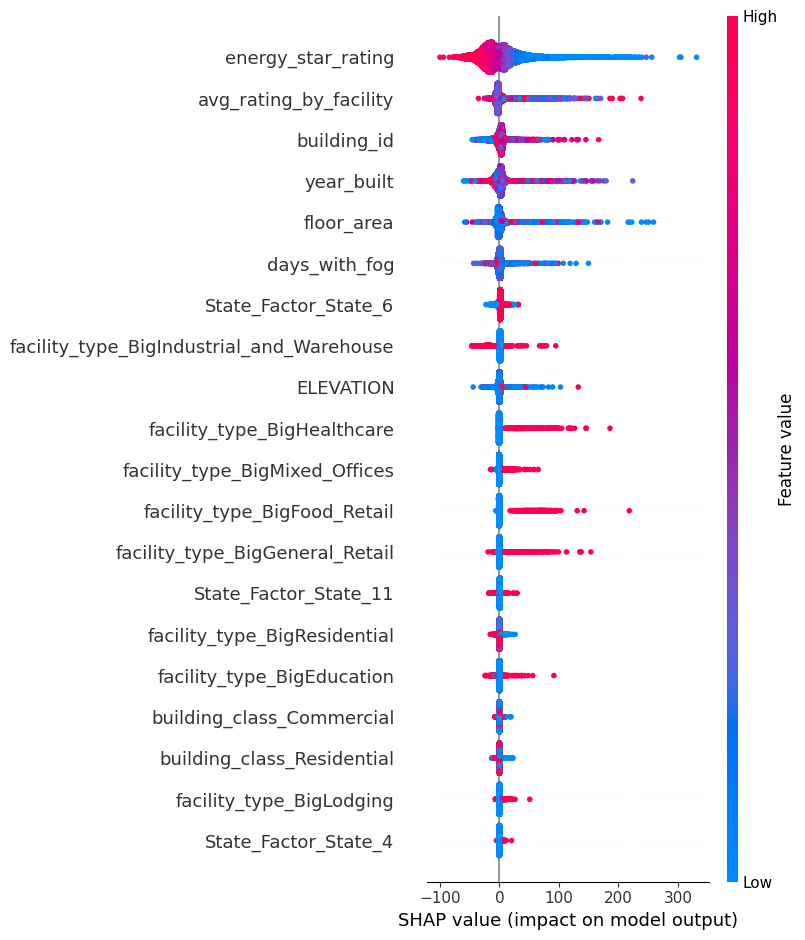

In [51]:
import joblib
import shap

# SHAP
# summary_plot
explainer = shap.TreeExplainer(loaded_model)
shap_values = explainer.shap_values(X_train_processed)  # 원-핫 인코딩된 데이터 사용
shap.summary_plot(shap_values, X_train_processed, feature_names=X_train_processed.columns)



In [54]:
# 전체 데이터에 대한 SHAP 시각화 

# SHAP explainer 생성
explainer = shap.TreeExplainer(loaded_model)

# SHAP interaction values 계산
shap_interaction_values = explainer.shap_interaction_values(X_train_processed)

# SHAP summary plot
shap.summary_plot(shap_interaction_values, X_train_processed, feature_names=X_train_processed.columns)


In [ ]:
# SHAP interaction values 계산
shap_interaction_values = explainer.shap_interaction_values(X_train)

# SHAP summary plot
shap.summary_plot(shap_interaction_values, X_train)

In [65]:
X_train.isnull().sum()

State_Factor              0
building_class            0
facility_type             0
year_built                0
floor_area                0
energy_star_rating        0
days_with_fog             0
ELEVATION                 0
building_id               0
avg_rating_by_facility    0
dtype: int64

### PDP(Partial Dependence Plots)
##### PDP는 특성의 변화가 예측에 미치는 평균적인 영향을 보여준다.

<Figure size 800x600 with 0 Axes>

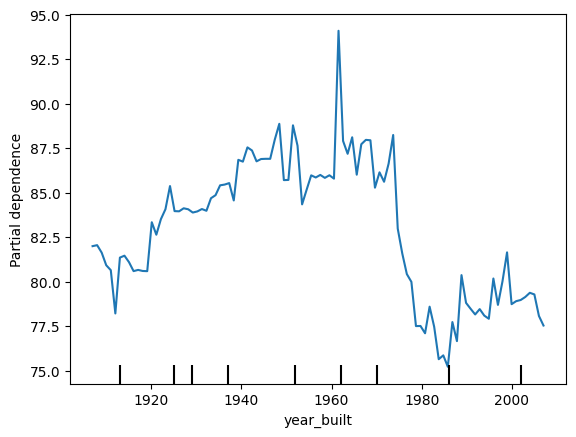

<Figure size 800x600 with 0 Axes>

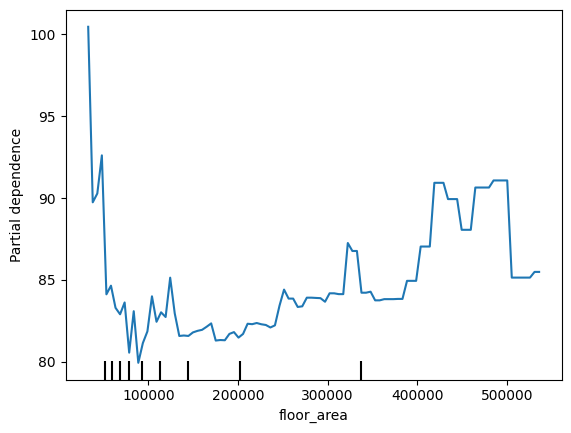

<Figure size 800x600 with 0 Axes>

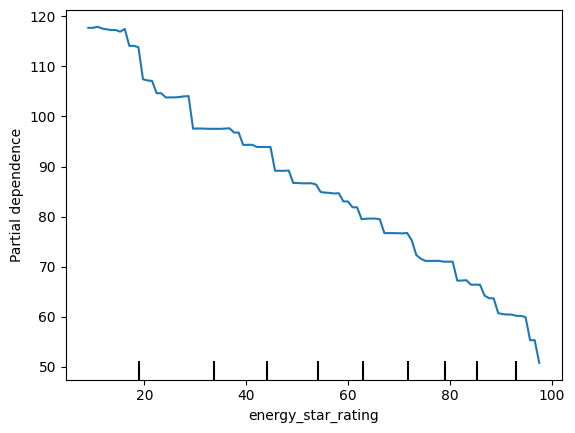

<Figure size 800x600 with 0 Axes>

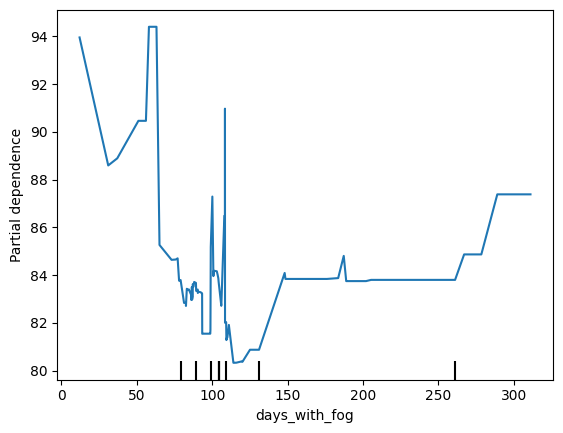

<Figure size 800x600 with 0 Axes>

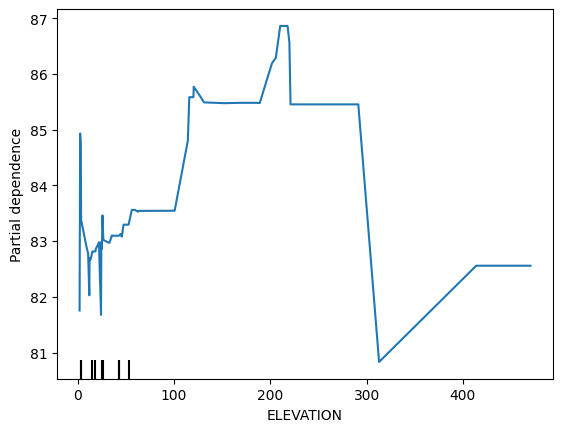

<Figure size 800x600 with 0 Axes>

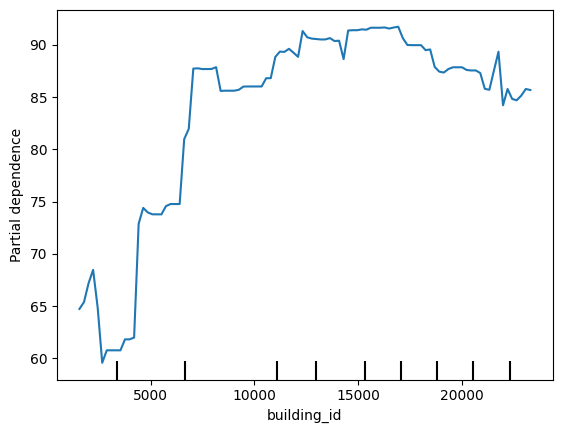

<Figure size 800x600 with 0 Axes>

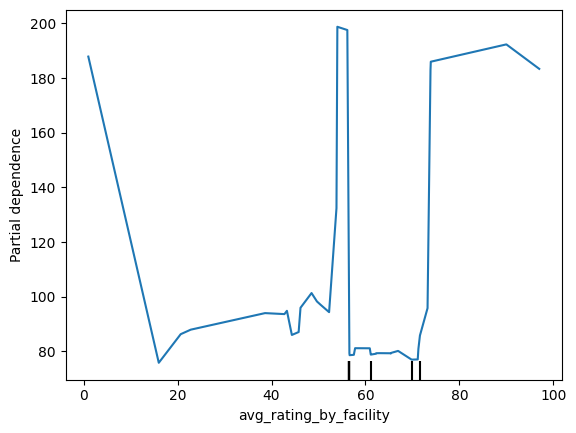

In [66]:
from sklearn.inspection import PartialDependenceDisplay, partial_dependence
import matplotlib.pyplot as plt

#PDP는 특성 값이 변화함에 따라 예측이 어떻게 변하는지 보여줍니다. 따라서 PDP의 기울기는 특성 값의 변화가 예측에 미치는 영향의 크기를 나타냅니다.
#PDP가 긍정의 기울기를 가지면, 해당 특성의 값이 증가할수록 예측 값도 증가한다는 것을 나타냅니다. 반대로, PDP가 부정의 기울기를 가지면, 해당 특성의 값이 증가할수록 예측 값은 감소한다는 것을 나타냅니다.
#PDP가 수평선에 가까우면, 해당 특성의 값이 예측에 큰 영향을 미치지 않는다는 것을 나타냅니다. 반대로, PDP가 수평선에서 크게 벗어나면, 해당 특성의 값이 예측에 큰 영향을 미친다는 것을 나타냅니다.

from sklearn.inspection import PartialDependenceDisplay, partial_dependence
import matplotlib.pyplot as plt

# 수치형 특성만 선택
numeric_features = X_train.select_dtypes(include=[np.number]).columns.tolist()

for feature in numeric_features:
    plt.figure(figsize=(8, 6))  # 각 그림의 크기 설정
    PartialDependenceDisplay.from_estimator(pipeline, X_train, [feature])
    plt.show()




In [ ]:
# PDP
# 두 feature의 예측값 비교

PartialDependenceDisplay.from_estimator(model, X_train, ['year_built', 'floor_area', 'energy_star_rating', 'days_with_fog','ELEVATION'])  
plt.show()

# Hypothesis test

1. t-검정(t-test): 이 검정은 두 집단의 평균이 서로 동일한지 비교할 때 사용됩니다. t-검정은 주로 표본 크기가 작을 때(30개 미만) 또는 모집단의 표준편차가 알려져 있지 않을 때 사용합니다.  
- 데이터는 정규 분포를 따라야 합니다.
- 두 그룹의 분산이 동일하다는 가정이 필요합니다(등분산성).
- 관찰은 독립적이어야 합니다.  

2. z-검정(z-test): 이 검정은 큰 표본(30개 이상)에 대해 평균을 비교하거나, 모집단의 비율을 비교할 때 사용됩니다.  
- 데이터는 정규 분포를 따라야 합니다.
- 모집단의 표준편차가 알려져 있어야 합니다.
- 관찰은 독립적이어야 합니다.  

3. 카이제곱 검정(Chi-Square Test): 이 검정은 범주형 데이터에 대해 사용됩니다. 두 범주형 변수 간의 독립성을 검정하거나, 한 범주형 변수의 분포가 기대 분포와 일치하는지를 검정할 때 사용됩니다.  
- 데이터는 범주형이어야 합니다.
- 관찰은 독립적이어야 합니다.
- 각 카테고리에 충분한 관찰 수(일반적으로 5 이상)가 있어야 합니다.  

4.  Shapiro-Wilk 검정: 이 검정은 데이터가 정규 분포를 따르는지를 검정하는 데 사용됩니다.

5. Cohen's d: 두 집단의 평균 차이를 표준 편차로 표준화한 것으로, 효과 크기(effect size)를 측정하는 데 사용되는 지표입니다.

In [ ]:
import pandas as pd
import numpy as np
from scipy import stats
import statsmodels.api as sm
from statsmodels.formula.api import ols

# 데이터 로드 - 여기서 'data'는 분석할 데이터프레임을 가리킵니다
# 예시로, 'data = pd.read_csv("your_data.csv")'로 데이터를 불러옵니다
clean_data = data.copy()

# year_built를 기준으로 오름차순 정렬
clean_data.sort_values('year_built', ascending=True, inplace=True)

# 에너지 스타 등급을 year_built로 선형회귀분석
energy_star_model = ols('energy_star_rating ~ year_built', data=clean_data).fit()
print(energy_star_model.summary())

# 사이트 에너지 사용률을 year_built로 선형회귀분석
site_eui_model = ols('site_eui ~ year_built', data=clean_data).fit()
print(site_eui_model.summary())

# 결측값 제거
clean_data = clean_data.dropna(subset=['year_built', 'energy_star_rating', 'site_eui'])

# 에너지 스타 등급과 사이트 에너지 사용률 각각에 대해 year_built와의 상관분석
energy_star_corr = stats.pearsonr(clean_data['year_built'], clean_data['energy_star_rating'])
site_eui_corr = stats.pearsonr(clean_data['year_built'], clean_data['site_eui'])

# 결과 출력
print(f"Energy Star Rating Correlation: r={energy_star_corr[0]:.4f}, p-value={energy_star_corr[1]:.4e}")
print(f"Site EUI Correlation: r={site_eui_corr[0]:.4f}, p-value={site_eui_corr[1]:.4e}")


energy_star_rating 상위 25% + site_eui 하위 25% 기준 특징 파악하기

In [ ]:
clean_data = data.copy()  # 예제 데이터 `data`를 복사해서 사용함
#clean_data = clean_data.dropna()

# 핵심 인자를 기준으로 그룹화하고 건물 ID 생성하기
clean_data['building_id'] = clean_data.groupby(['State_Factor', 'building_class', 'facility_type', 'floor_area', 'year_built']).ngroup()

# 시설 유형별 에너지 등급의 평균 계산하기
clean_data['avg_rating_by_facility'] = clean_data.groupby('facility_type')['energy_star_rating'].transform('mean')

# 고유한 건물 식별을 위한 그룹 데이터 생성하기
grouped_data = clean_data.groupby('building_id').agg({
    'State_Factor': 'first',
    'building_class': 'first',
    'facility_type': 'first',
    'year_built': 'first',
    'floor_area': 'first',
    'energy_star_rating': 'mean',
    'days_with_fog': 'mean',
    'ELEVATION': 'mean',
    'avg_rating_by_facility': 'first',
    'site_eui': 'mean'
})

# 상위 25% 에너지 스타 등급과 하위 25% site_eui 를 만족하는 건물 추출하기
top_energy_star_rating = grouped_data['energy_star_rating'].quantile(0.75)
low_site_eui = grouped_data['site_eui'].quantile(0.25)
top_efficient_buildings = grouped_data[(grouped_data['energy_star_rating'] >= top_energy_star_rating) &
                                       (grouped_data['site_eui'] <= low_site_eui)]

# 상위 건물의 특징 탐색하기
features_of_efficient_buildings = top_efficient_buildings.describe()

print(features_of_efficient_buildings)


In [ ]:
# 중복된 행을 제거합니다(subset 옵션으로 특정 컬럼을 명시).
top_efficient_buildings = top_efficient_buildings.drop_duplicates(subset=['State_Factor', 'building_class', 'facility_type', 'year_built'])

In [ ]:
top_efficient_buildings.describe(include='all')

연도에 따른 면적 변화 관찰하기

In [ ]:
import plotly.express as px
# 건축 연도(year_built)가 최신 순으로 정렬
df_sorted = df.sort_values('year_built', ascending=False)

# `year_built` 기준으로 최신 데이터 필터링
latest_threshold_year = min(df['year_built'])  # 예: 2015년 이후 데이터만 포함
latest_df = df[df['year_built'] >= latest_threshold_year]

# Plotly를 이용해 산점도 시각화
fig = px.scatter(latest_df, x='year_built', y='floor_area',
                 title='Floor Area vs Year Built for Recent Buildings',
                 labels={'year_built': 'Year Built', 'floor_area': 'Floor Area'})

# 그래프 표시
fig.show()

핵심 변수와 타겟 변수간의 가설 설정

In [ ]:
import pandas as pd
import numpy as np
from scipy import stats
import statsmodels.api as sm
from statsmodels.formula.api import ols

# 데이터 로드
clean_data = data.copy()

# 위의 특성을 기반으로 그룹화하고, 각 그룹에 대해 고유한 ID를 생성.
clean_data['building_id'] = clean_data.groupby(['State_Factor', 'building_class', 'facility_type', 'floor_area', 'year_built']).ngroup()
# 이제 'facility_type'와 'energy_star_rating'을 이용해 시설 유형별 에너지 등급 평균을 계산.
clean_data['avg_rating_by_facility'] = clean_data.groupby('facility_type')['energy_star_rating'].transform('mean')

# State Factor 별 에너지 효율성 가설 검증
state_group = clean_data.groupby('State_Factor')['energy_star_rating'].mean()
anova_state = stats.f_oneway(*[group['energy_star_rating'].dropna() for name, group in clean_data.groupby('State_Factor')])
print(f'State Factor ANOVA p-value: {anova_state.pvalue}')

###

# 건물 연식과 에너지 효율성 상관관계 가설 검증
year_built = clean_data['year_built']
energy_star_rating = clean_data['energy_star_rating']

# 결측치가 없는 인덱스만 추출
non_na_indices = year_built.dropna().index.intersection(energy_star_rating.dropna().index)

# 두 변수 모두 결측치가 없는 인덱스를 사용하여 데이터 추출
year_built_clean = year_built.loc[non_na_indices]
energy_star_rating_clean = energy_star_rating.loc[non_na_indices]

# 추출된 데이터로 피어슨 상관계수 계산
corr_coef, p_value = stats.pearsonr(year_built_clean, energy_star_rating_clean)
print(f'Pearson correlation p-value: {p_value}')

###

# 건물 면적에 따른 에너지 사용량 가설 검증
slope, intercept, r_value, p_value, std_err = stats.linregress(clean_data['floor_area'], clean_data['site_eui'])
print(f'Floor Area vs. Site EUI p-value: {p_value}')

###

# 시설 유형별 에너지 효율성 차이 가설 검증
model = ols('energy_star_rating ~ C(facility_type)', data=clean_data).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
print(anova_table)

###

# 안개 발생 일수와 에너지 효율성 관계 가설 검증
foggy_days_model = ols('energy_star_rating ~ days_with_fog', data=clean_data).fit()
foggy_days_anova = sm.stats.anova_lm(foggy_days_model, typ=2)
print(foggy_days_anova)
